# Projet Spark - Boardgames

## Importation

In [1]:
import sparknlp
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import pyspark.pandas as ps
from pyspark.sql.functions import monotonically_increasing_id, explode, collect_list, sort_array, struct
from pyspark.sql.functions import collect_list
from pyspark.sql.functions import array_contains
from pyspark.sql.functions import concat_ws
from pyspark.sql.functions import col
from pyspark.sql.functions import first
from pyspark.ml import PipelineModel
from sparknlp.annotator import *
from sparknlp.base import *
from sparknlp.pretrained import PretrainedPipeline
from pyspark.sql.functions import udf
from pyspark.sql.types import StringType
from pyspark.sql.functions import concat_ws
import json
import pyspark.sql.functions as F
from pyspark.ml import Pipeline
from sparknlp.annotator import *
from sparknlp.base import *
from sparknlp.pretrained import PretrainedPipeline
from pyspark.sql.types import StringType, IntegerType
from hdfs import InsecureClient

/data/spark-project-22205250/venv/lib/python3.11/site-packages/pyspark/pandas/__init__.py:50: UserWarning: 'PYARROW_IGNORE_TIMEZONE' environment variable was not set. It is required to set this environment variable to '1' in both driver and executor sides if you use pyarrow>=2.0.0. pandas-on-Spark will set it for you but it does not work if there is a Spark context already launched.
  warnings.warn(


In [2]:
pd.set_option('display.max_rows', None)  
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

## Configuration de la session Spark

In [3]:
!whoami

spark


In [4]:
print("***********************************************************************************************")
print("\t\t\t\t PROJET SPARK ")
print("***********************************************************************************************")

***********************************************************************************************
				 PROJET SPARK 
***********************************************************************************************


In [5]:
!pip show pyspark

Name: pyspark
Version: 3.5.0
Summary: Apache Spark Python API
Home-page: https://github.com/apache/spark/tree/master/python
Author: Spark Developers
Author-email: dev@spark.apache.org
License: http://www.apache.org/licenses/LICENSE-2.0
Location: /data/spark-project-22205250/venv/lib/python3.11/site-packages
Requires: py4j
Required-by: 


In [6]:
!pip show spark-nlp

Name: spark-nlp
Version: 5.2.3
Summary: John Snow Labs Spark NLP is a natural language processing library built on top of Apache Spark ML. It provides simple, performant & accurate NLP annotations for machine learning pipelines, that scale easily in a distributed environment.
Home-page: https://github.com/JohnSnowLabs/spark-nlp
Author: John Snow Labs
Author-email: 
License: 
Location: /data/spark-project-22205250/venv/lib/python3.11/site-packages
Requires: 
Required-by: 


In [8]:
from pyspark.sql import SparkSession

chemin_jar_spark_nlp = "../jars/spark-nlp-assembly-5.2.3.jar"
chemin_jar_hadoop_aws = "../jars/hadoop-aws-3.3.6.jar"
chemin_jar_aws_sdk = "../jars/aws-java-sdk-bundle-1.12.655.jar"
chemin_jar_tensor = "../jars/tensorflow-core-platform-0.5.0.jar"
chemin_jar_slf4j = "../jars/slf4j-api-2.0.12.jar"
chemins_jars = ",".join([chemin_jar_spark_nlp, chemin_jar_aws_sdk, chemin_jar_hadoop_aws, chemin_jar_tensor])

spark = SparkSession.builder \
    .appName("SPARK NLP PROJECT") \
    .master("spark://192.168.33.50:7077") \
    .config("spark.executor.memory", "30g") \
    .config("spark.driver.memory", "30g") \
    .config("spark.executor.cores", "12") \
    .config("spark.executor.instances", "4") \
    .config("spark.jars", chemins_jars) \
    .config("spark.driver.extraJavaOptions", "-Xss4m") \
    .config("spark.executor.extraJavaOptions", "-Xss4m") \
    .getOrCreate()

24/03/04 13:52:07 WARN Utils: Your hostname, spark resolves to a loopback address: 127.0.1.1; using 192.168.33.50 instead (on interface ens192)
24/03/04 13:52:07 WARN Utils: Set SPARK_LOCAL_IP if you need to bind to another address
24/03/04 13:52:08 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable
24/03/04 13:52:08 WARN SparkConf: Note that spark.local.dir will be overridden by the value set by the cluster manager (via SPARK_LOCAL_DIRS in mesos/standalone/kubernetes and LOCAL_DIRS in YARN).
24/03/04 13:52:09 WARN Utils: Service 'SparkUI' could not bind on port 4040. Attempting port 4041.


In [8]:
print("Spark NLP version", sparknlp.version())
print("Apache Spark version:", spark.version)

spark

Spark NLP version 5.2.3
Apache Spark version: 3.5.0


In [10]:
hdfs_host = '192.168.33.50'
hdfs_port = 8020
hdfs = f"hdfs://{hdfs_host}:{hdfs_port}/user/spark/spark-project-22205250"

## Importation des pretrained Models

dans cette cellule je définis les path dans hdfs de chaque annotator

In [10]:
sentencer = f'{hdfs}/pretrained/sentence_detector_dl_xx'
# languager= f'hdfs://192.168.33.50:8020/user/spark/spark-project-22205250/pretrained/ld_wiki_cnn_231_xx_2.7.0_2.4_1607183625658'
languager= f'{hdfs}/pretrained/ld_wiki_tatoeba_cnn_375_xx'
languager_pipeline = f"{hdfs}/pretrained/detect_language_375_xx_2.7.0_2.4_1607185980306"
base_bert_sentence_embeddings = f"{hdfs}/pretrained/sent_bert_base_cased_en_2.6.0_2.4_1598346030732"
large_universal_sentence_embeddings = f"{hdfs}/pretrained/tfhub_use_lg_en_2.4.0_2.4_1587136993894"
base_universal_sentence_embeddings  = f"{hdfs}/pretrained/tfhub_use_en_2.4.0_2.4_1587136330099"

## Lire les données JSON de système de fichier local et les nettoyer

In [29]:
df = pd.read_json("file:///data/spark-project-22205250/json-data/bgg_data.json")

In [33]:
print(df['published_year'].value_counts().to_string(max_rows=None))

published_year
 0       11308
 2019     7714
 2018     7201
 2020     7147
 2021     6948
 2022     6743
 2017     6682
 2023     6619
 2016     6378
 2015     5957
 2014     5365
 2013     4581
 2012     4335
 2011     3935
 2010     3550
 2009     3466
 2008     3096
 2007     2954
 2005     2804
 2006     2770
 2004     2325
 2003     1964
 2002     1820
 2024     1743
 2001     1566
 2000     1462
 1999     1341
 1998     1249
 1995     1082
 1997     1067
 1996     1035
 1992     1025
 1987      991
 1994      988
 1990      984
 1986      961
 1991      954
 1989      932
 1985      930
 1993      919
 1988      889
 1984      825
 1983      788
 1981      653
 1980      647
 1975      615
 1982      615
 1979      600
 1977      593
 1978      544
 1976      540
 1973      442
 1974      439
 1970      370
 1972      360
 1969      320
 1971      279
 1965      236
 1968      226
 1967      225
 1960      220
 1955      200
 1930      196
 1964      193
 1963      183
 1950     

In [34]:
def change_negative_years(annee: int)-> int:
    if annee < 1950:
        annee = 1950
    return annee

In [35]:
df["published_year"] = df["published_year"].apply(change_negative_years)

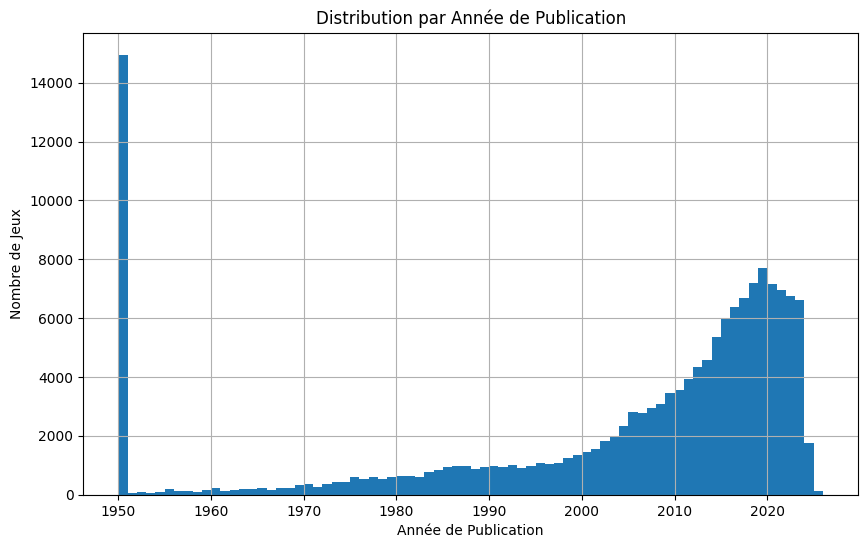

In [36]:
# Histogramme pour 'published_year'
plt.figure(figsize=(10, 6))
df['published_year'].hist(bins=range(df['published_year'].min(), df['published_year'].max() + 1))
plt.title('Distribution par Année de Publication')
plt.xlabel('Année de Publication')
plt.ylabel('Nombre de Jeux')
plt.show()

In [39]:
df= df.drop(columns=['updated_at', 'updated_by'], axis = 1)

## Partitionnement des données | Ecriture sur HDFS

In [41]:
bgg_data = spark.createDataFrame(df) 

In [32]:
bgg_data.printSchema()

root
 |-- created_at: timestamp (nullable = true)
 |-- object_id: long (nullable = true)
 |-- url: string (nullable = true)
 |-- name: string (nullable = true)
 |-- description: string (nullable = true)
 |-- created_by: long (nullable = true)
 |-- published_year: long (nullable = true)
 |-- min_player: long (nullable = true)
 |-- max_player: long (nullable = true)
 |-- playing_time: long (nullable = true)
 |-- playing_min_time: long (nullable = true)
 |-- playing_max_time: long (nullable = true)
 |-- age: long (nullable = true)
 |-- rank: long (nullable = true)
 |-- geek_rating: long (nullable = true)
 |-- avg_rating: long (nullable = true)
 |-- num_voters: long (nullable = true)
 |-- boardgame_reimplemented: array (nullable = true)
 |    |-- element: long (containsNull = true)
 |-- subdomain: array (nullable = true)
 |    |-- element: long (containsNull = true)
 |-- mechanism: array (nullable = true)
 |    |-- element: long (containsNull = true)
 |-- family: array (nullable = true)
 |

La cellule ci dessous a servi pour le partitionnement des données sur HDFS selon l'attribut published_year

In [33]:
#Partitionnement des données sur hdfs 
#Le partitionnement se fait sur la colonne published year
######
# bgg_data.write.partitionBy("published_year").parquet(f'hdfs://{hdfs}/user/spark/spark-project-22205250/data/complete_bgg_data')
######

24/02/10 20:13:50 WARN TaskSetManager: Stage 1 contains a task of very large size (4902 KiB). The maximum recommended task size is 1000 KiB.


# BoardGames Categories Classifier

## Preprocessing

### Lecture des données à partir du HDFS

Lecture des données distribué de boardgame sotocké précedemment dans hdfs

In [9]:
bgg_data = spark.read.parquet(f'{hdfs}/data/complete_bgg_data')
bgg_data.printSchema()

root
 |-- created_at: timestamp (nullable = true)
 |-- object_id: long (nullable = true)
 |-- url: string (nullable = true)
 |-- name: string (nullable = true)
 |-- description: string (nullable = true)
 |-- created_by: long (nullable = true)
 |-- min_player: long (nullable = true)
 |-- max_player: long (nullable = true)
 |-- playing_time: long (nullable = true)
 |-- playing_min_time: long (nullable = true)
 |-- playing_max_time: long (nullable = true)
 |-- age: long (nullable = true)
 |-- rank: long (nullable = true)
 |-- geek_rating: long (nullable = true)
 |-- avg_rating: long (nullable = true)
 |-- num_voters: long (nullable = true)
 |-- boardgame_reimplemented: array (nullable = true)
 |    |-- element: long (containsNull = true)
 |-- subdomain: array (nullable = true)
 |    |-- element: long (containsNull = true)
 |-- mechanism: array (nullable = true)
 |    |-- element: long (containsNull = true)
 |-- family: array (nullable = true)
 |    |-- element: long (containsNull = true)


### Test English description Extractor PipeLine

In [68]:
def extract_english_parts(description, sentence_extractor_pipeline, language_detector_pipeline):

    if not description:
        return ""
    
    # Extraction des phrases
    sentences = (anno.result for anno in sentence_extractor_pipeline.fullAnnotate(description)[0]["sentences"]) #OK 
    
    # Détection de la langue pour chaque phrase
    english_text = ' '.join(
        sentence['document'][0] 
        for sentence in (language_detector_pipeline.annotate(sentence) for sentence in sentences) 
        if 'en' in sentence['language']
    )

    print(f"Success")
    return english_text


In [53]:
documenter = DocumentAssembler()\
    .setInputCol("text")\
    .setOutputCol("document")

sentencerDL = SentenceDetectorDLModel\
    .load(sentencer) \
    .setInputCols(["document"]) \
    .setOutputCol("sentences")

sd_pipeline = PipelineModel(stages=[documenter, sentencerDL])
sd_model = LightPipeline(sd_pipeline)
pipeline = PretrainedPipeline("detect_language_375", disk_location=languager_pipeline)

In [54]:
japonaise = "User summary時の祭壇 (Toki no Saidan), in English would be 'Altar of Time', a card game with a theme of time. The game is #1 in a series of 5 games, published as a bookshelf volume 'Ars Combinatoria'. The game is published in both Japanese and English.The key of the game is the ultimate decision between these two: circulating time which denies changes, and flowing time which accepts changes.Players always have eight cards during play. At the end of the game, the player who has the highest value in their hand wins the game.They maintain their own schedule in front of them, which determines their actions. Each turn, you may add and remove activity cards in your schedule or your opponent's. Time to be consumed is printed in each card. You must always keep the schedule exactly 24 hours.To win the game, you should strengthen your schedule while weakening opponent's schedule.Publisher's summary「時間」をテーマにしたゲームです。「すすむ時間」と「まわる時間」という究極の選択が鍵になります。各自が自分のデッキを持ってプレイします。待ち時間を我慢できるならば、何人でも同時にプレイできます。ただし、現実的には6人程度が最大プレイ人数です。自分や相手の予定表によって行動が規定されます。最後にもっとも多くの得点を手札に持っていた人が勝ちです。"
japonaise

"User summary時の祭壇 (Toki no Saidan), in English would be 'Altar of Time', a card game with a theme of time. The game is #1 in a series of 5 games, published as a bookshelf volume 'Ars Combinatoria'. The game is published in both Japanese and English.The key of the game is the ultimate decision between these two: circulating time which denies changes, and flowing time which accepts changes.Players always have eight cards during play. At the end of the game, the player who has the highest value in their hand wins the game.They maintain their own schedule in front of them, which determines their actions. Each turn, you may add and remove activity cards in your schedule or your opponent's. Time to be consumed is printed in each card. You must always keep the schedule exactly 24 hours.To win the game, you should strengthen your schedule while weakening opponent's schedule.Publisher's summary「時間」をテーマにしたゲームです。「すすむ時間」と「まわる時間」という究極の選択が鍵になります。各自が自分のデッキを持ってプレイします。待ち時間を我慢できるならば、何人でも同時にプレイできます。ただし、現

In [55]:
sentences = extract_english_parts(japonaise, sd_model, pipeline)

Success 1


In [56]:
sentences

"User summary時の祭壇 (Toki no Saidan), in English would be 'Altar of Time', a card game with a theme of time. The game is #1 in a series of 5 games, published as a bookshelf volume 'Ars Combinatoria'. The game is published in both Japanese and English. The key of the game is the ultimate decision between these two: circulating time which denies changes, and flowing time which accepts changes. Players always have eight cards during play. At the end of the game, the player who has the highest value in their hand wins the game. They maintain their own schedule in front of them, which determines their actions. Each turn, you may add and remove activity cards in your schedule or your opponent's. Time to be consumed is printed in each card. You must always keep the schedule exactly 24 hours. To win the game, you should strengthen your schedule while weakening opponent's schedule."

### Préparation des données Boardgames

In [11]:
document_assembler = DocumentAssembler() \
    .setInputCol("description") \
    .setOutputCol("document")

sentence_detector = SentenceDetectorDLModel.load(sentencer) \
    .setInputCols(["document"]) \
    .setOutputCol("sentences")

pipeline = Pipeline(stages=[document_assembler, sentence_detector])

2024-02-16 11:09:04.640850: I external/org_tensorflow/tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [12]:
processed_df = pipeline.fit(bgg_data).transform(bgg_data)

In [14]:
exploded_df = processed_df.withColumn("individual_sentence", explode("sentences.result"))

In [15]:
indexed_df = exploded_df.withColumn("index", monotonically_increasing_id())

In [17]:
document_assembler = DocumentAssembler() \
    .setInputCol("individual_sentence") \
    .setOutputCol("document")

sentence_detector = SentenceDetector() \
    .setInputCols(["document"]) \
    .setOutputCol("sentence")

language_detector = LanguageDetectorDL.load(languager) \
    .setInputCols(["sentence"]) \
    .setOutputCol("language")

finisher = Finisher() \
    .setInputCols(["language"]) \
    .setOutputCols(["language_result"])

nlp_pipeline = Pipeline(stages=[
    document_assembler, 
    sentence_detector, 
    language_detector, 
    finisher
])

In [18]:
processed_df = nlp_pipeline.fit(indexed_df).transform(indexed_df)

In [20]:
# Filtrer pour ne conserver que les phrases dont la liste de langues contient "en"
english_sentences_df = processed_df.filter(array_contains(processed_df.language_result, "en"))

In [21]:
grouped_df = english_sentences_df.groupBy("object_id").agg(
    sort_array(collect_list(struct("index", "individual_sentence"))).alias("sorted_sentences"),
    first("categories").alias("categories"),
    first("description").alias("description"),
    first("url").alias("url"),
    first("name").alias("name"),
    first("published_year").alias("published_year")

)

In [23]:
final_df = grouped_df.withColumn(
    "english_sentences", 
    concat_ws(" ", col("sorted_sentences.individual_sentence"))
)

In [29]:
final_df.filter(final_df.object_id==229217).select("description","english_sentences").show(truncate=False)

+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

#### Rename columns

In [25]:
final_df = final_df.withColumnRenamed("object_id", "boardgame_id")
final_df = final_df.withColumnRenamed("name", "boardgame_name")
final_df = final_df.withColumnRenamed("url", "boardgame_url")
final_df = final_df.withColumnRenamed("description", "boardgame_description")
final_df.printSchema()

root
 |-- boardgame_id: long (nullable = true)
 |-- sorted_sentences: array (nullable = false)
 |    |-- element: struct (containsNull = false)
 |    |    |-- index: long (nullable = false)
 |    |    |-- individual_sentence: string (nullable = true)
 |-- categories: array (nullable = true)
 |    |-- element: long (containsNull = true)
 |-- boardgame_description: string (nullable = true)
 |-- boardgame_url: string (nullable = true)
 |-- boardgame_name: string (nullable = true)
 |-- published_year: integer (nullable = true)
 |-- english_sentences: string (nullable = false)



### Persistance en mémoire
Je persiste le dataset en mémoire, pour accélèrer l'accès par la suite.
Je peux à tout moment faire unpersist pour la supprimer du mémoire.
source : https://sparkbyexamples.com/spark/spark-dataframe-cache-and-persist-explained/

In [ ]:
# final_df.cache()
# final_df.count()

In [49]:
final_df.filter(final_df.boardgame_id==174430).select("boardgame_description","english_sentences").show(truncate=False)

+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

### Boardgames categories data Preprocessing

In [43]:
categories_pd_df = pd.read_json("file:///data/spark-project-22205250/json-data/bgg_category_data.json")
categories_pd_df = categories_pd_df.drop(columns=['updated_at', 'updated_by'], axis = 1)
categories_pd_df

,created_at,object_id,url,name,description,created_by,boardgames
0,2024-01-05 00:19:43.671823,2145,https://boardgamegeek.com/boardgamecategory/21...,Medical,games have themes related to the science of na...,22205250,"[161936, 221107, 198928, 30549, 150658, 238799..."
1,2024-01-05 00:19:45.084036,1084,https://boardgamegeek.com/boardgamecategory/10...,Environmental,games often have themes and storylines regardi...,22205250,"[161936, 342942, 167791, 251247, 295947, 22110..."
2,2024-01-05 00:19:46.500944,1017,https://boardgamegeek.com/boardgamecategory/10...,Dice,games often use dice as its sole or principal ...,22205250,"[84876, 192135, 251661, 73439, 171623, 172287,..."
3,2024-01-05 00:19:47.946835,1035,https://boardgamegeek.com/boardgamecategory/10...,Medieval,games that have themes or storylines set in Eu...,22205250,"[84876, 177736, 164928, 244521, 266810, 93, 23..."
4,2024-01-05 00:19:49.345334,1086,https://boardgamegeek.com/boardgamecategory/10...,Territory Building,games have the players establish and/or amass ...,22205250,"[84876, 115746, 162886, 169786, 220308, 237182..."
...,...,...,...,...,...,...,...
79,2024-01-05 00:21:42.948166,1027,https://boardgamegeek.com/boardgamecategory/10...,Trivia,games often test players on their knowledge of...,22205250,"[20100, 241590, 35497, 85256, 113401, 318243, ..."
80,2024-01-05 00:21:42.997910,1119,https://boardgamegeek.com/boardgamecategory/11...,Game System,"A is an item whose components are not a game, ...",22205250,"[290484, 152, 21804, 37301, 5451, 4505, 295574..."
81,2024-01-05 00:21:43.037904,1091,https://boardgamegeek.com/boardgamecategory/10...,Korean War,games cover the military conflict between Nort...,22205250,"[22877, 7349, 6581, 139433, 3711, 7251, 346248..."
82,2024-01-05 00:21:43.077158,1117,https://boardgamegeek.com/boardgamecategory/11...,Book,"games are not games , but rather a collection ...",22205250,"[325555, 21133, 184824, 197097, 177354, 274428..."


In [44]:
categories_sdf = spark.createDataFrame(categories_pd_df) 
categories_sdf.printSchema()

root
 |-- created_at: timestamp (nullable = true)
 |-- object_id: long (nullable = true)
 |-- url: string (nullable = true)
 |-- name: string (nullable = true)
 |-- description: string (nullable = true)
 |-- created_by: long (nullable = true)
 |-- boardgames: array (nullable = true)
 |    |-- element: long (containsNull = true)



In [45]:
categories_sdf = categories_sdf.withColumnRenamed("object_id", "category_id")
categories_sdf = categories_sdf.withColumnRenamed("name", "category_name")
categories_sdf = categories_sdf.withColumnRenamed("url", "category_url")
categories_sdf = categories_sdf.withColumnRenamed("description", "category_description")

#### Write BGG Categories on HDFS

Stocker les donnes des categories dans HDFS

In [52]:
# Write boardgame_category on hdfs 
# categories_sdf.write.parquet(f'hdfs://192.168.33.50:8020/user/spark/spark-project-22205250/data/bgg_categories')

### Boardgames categories data From HDFS

Lecture des boardgame categories precedement stocké dans HDFS

In [11]:
# Read bgg_categories from  HDFS
categories_data = spark.read.parquet(f'{hdfs}/data/bgg_categories')

### Jointure entre final_df et categories_data

In [27]:
bgg_sdf_exploded = final_df.withColumn("bgg_category_id", explode("categories"))

In [29]:
bgg_sdf_exploded_joined_categories_sdf = bgg_sdf_exploded.join(categories_data, bgg_sdf_exploded.bgg_category_id == categories_data.category_id, "inner")

In [30]:
# Grouper par les colonnes nécessaires et agréger les IDs et les noms de catégories
result_df = bgg_sdf_exploded_joined_categories_sdf.groupBy(
    "boardgame_id", 
    "boardgame_url", 
    "boardgame_name", 
    "boardgame_description", 
    "english_sentences"
).agg(
    F.collect_list("category_id").alias("categories"),
    F.collect_list("category_name").alias("categories_name")
)


### Ecriture du dataset resultat en HDFS

Enregistrement de DF resultat dans HDFS afin qu'il soit un point de depart pour les prochains traitements notamment l'entrainement des modèls

In [32]:
# result_df.write.parquet(f'hdfs://192.168.33.50:8020/user/spark/spark-project-22205250/data/bgg_categories_dataset')

## Training

### Splitting the dataset

In [17]:
dataset = spark.read.parquet(f'{hdfs}/data/bgg_categories_dataset')
dataset.printSchema()

root
 |-- boardgame_id: long (nullable = true)
 |-- boardgame_url: string (nullable = true)
 |-- boardgame_name: string (nullable = true)
 |-- boardgame_description: string (nullable = true)
 |-- english_sentences: string (nullable = true)
 |-- categories: array (nullable = true)
 |    |-- element: long (containsNull = true)
 |-- categories_name: array (nullable = true)
 |    |-- element: string (containsNull = true)



Select que english_sentences et catgories_name, que nous aurions besoin pour entrainer le model.

In [18]:
select_df = dataset.select("english_sentences", "categories_name")
select_df.printSchema()

root
 |-- english_sentences: string (nullable = true)
 |-- categories_name: array (nullable = true)
 |    |-- element: string (containsNull = true)



Trouver un bon ratio pour splitter les données : 
1. __140000__  textes de description pour l'ensemble d'entrainement, dont __10000__ sont destinés pour la validation.
2. __8253__ textes de description pour le test. 

In [20]:
total_rows = select_df.count()
test_ratio = 8253 / total_rows
train_ratio = 1 - test_ratio

In [21]:
# Splitting the dataset : 
train_set, test_set = select_df.randomSplit([train_ratio, test_ratio], seed = 42)

In [22]:
train_set.show(1,truncate=False)

+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

In [23]:
from pyspark.sql.functions import col, array
from pyspark.sql.types import StringType, ArrayType

train_set = train_set.withColumn("categories_name_compatible", col("categories_name").cast(ArrayType(StringType(), True)))

In [24]:
train_set.printSchema()

root
 |-- english_sentences: string (nullable = true)
 |-- categories_name: array (nullable = true)
 |    |-- element: string (containsNull = true)
 |-- categories_name_compatible: array (nullable = true)
 |    |-- element: string (containsNull = true)



### Models Creation

Création de pipeline: 

**texte brute -> Document annotator -> sentence detector annotator -> BERT / USE / RoBerta -> model**

In [28]:
import sparknlp
import pandas as pd
import pyspark.sql.functions as F
from pyspark.ml import Pipeline, PipelineModel
from pyspark.sql.functions import array_contains
from sparknlp.annotator import *
from sparknlp.common import RegexRule
from sparknlp.base import DocumentAssembler, Finisher
from sparknlp.base import LightPipeline

In [29]:
document = DocumentAssembler()\
              .setInputCol("english_sentences")\
              .setOutputCol("document")\
              .setCleanupMode("shrink")


sentenceDetector = SentenceDetector()\
    .setInputCols(['document'])\
    .setOutputCol('sentences')

validation_split = 10000 / 140000 

### Using Base BERT Sentence Embeddings

In [138]:
bert_sent = BertSentenceEmbeddings.load(base_bert_sentence_embeddings)\
              .setInputCols(["document"])\
              .setOutputCol("sentence_embeddings")


multiClassifier = MultiClassifierDLApproach()\
              .setInputCols("sentence_embeddings")\
              .setOutputCol("categories_hat")\
              .setLabelColumn("categories_name_compatible")\
              .setBatchSize(130)\
              .setMaxEpochs(100)\
              .setLr(3e-3)\
              .setVerbose(2)\
              .setEvaluationLogExtended(True)\
              .setShufflePerEpoch(True)\
              .setThreshold(0.48)\
              .setShufflePerEpoch(False)\
              .setEnableOutputLogs(True)\
              .setOutputLogsPath(f"{hdfs}/logs")\
              .setValidationSplit(validation_split) 



pipeline_bert = Pipeline(stages = [document, bert_sent, multiClassifier])

In [126]:
%%time
pipelineModel = pipeline_bert.fit(train_set)

2024-02-17 16:41:42.886722: I external/org_tensorflow/tensorflow/cc/saved_model/reader.cc:43] Reading SavedModel from: /tmp/7fffd6a45069_classifier_dl15538571997345406661
2024-02-17 16:41:43.937740: I external/org_tensorflow/tensorflow/cc/saved_model/reader.cc:107] Reading meta graph with tags { serve }
2024-02-17 16:41:43.937796: I external/org_tensorflow/tensorflow/cc/saved_model/reader.cc:148] Reading SavedModel debug info (if present) from: /tmp/7fffd6a45069_classifier_dl15538571997345406661
2024-02-17 16:41:49.533179: I external/org_tensorflow/tensorflow/cc/saved_model/loader.cc:228] Restoring SavedModel bundle.
2024-02-17 16:41:52.214286: I external/org_tensorflow/tensorflow/cc/saved_model/loader.cc:212] Running initialization op on SavedModel bundle at path: /tmp/7fffd6a45069_classifier_dl15538571997345406661
2024-02-17 16:41:53.865965: I external/org_tensorflow/tensorflow/cc/saved_model/loader.cc:301] SavedModel load for tags { serve }; Status: success: OK. Took 10979250 micros

Training started - epochs: 100 - learning_rate: 0.003 - batch_size: 130 - training_examples: 130000 - classes: 84
Epoch 1/100 - 15,21s - loss: 0.0849053 - acc: 0.9731159 - batches: 1000
Quality on validation dataset (7.1428576%), validation examples = 10000 
time to finish evaluation: 7,14s
label                        tp	 fp	 fn	 prec	 rec	 f1
Action / Dexterity           116	 21	 329	 0.84671533	 0.26067415	 0.39862543
Electronic                   3	 1	 80	 0.75	 0.036144577	 0.06896552
Real-time                    0	 0	 213	 0.0	 0.0	 0.0
Racing                       89	 23	 223	 0.79464287	 0.28525642	 0.4198113
Wargame                      1305	 264	 247	 0.83173996	 0.84085053	 0.83627045
Card Game                    1371	 477	 1293	 0.7418831	 0.5146396	 0.6077128
Party Game                   303	 173	 567	 0.6365546	 0.34827587	 0.45022285
Political                    39	 22	 108	 0.6393443	 0.26530612	 0.375
Fan Expansion                0	 0	 36	 0.0	 0.0	 0.0
Abstract Strateg

In [141]:
pipelineModel.stages

[DocumentAssembler_6855dbef801e,
 BERT_SENTENCE_EMBEDDINGS_68370801062d,
 MultiClassifierDLModel_0dbd7d55dc3b]

Sauvegarder Multilabel Classifier Model sur HDFS

In [128]:
pipelineModel.stages[2].write().overwrite().save(f'{hdfs}/models/MultilabelClfDocBert-48Thresh-100epochs-3e3lr')

#### Application du model sur l'ensemble du test et Evaluation

Charger le Multilabel Classifier Model 

In [145]:
Classifier_Model_Bert = MultiClassifierDLModel.load(f'{hdfs}/models/MultilabelClfDocBert-48Thresh-100epochs-3e3lr')

In [149]:
pipeline_bert = Pipeline(stages = [document, bert_sent, Classifier_Model_Bert])
ld_pipeline_model = pipeline_bert.fit(spark.createDataFrame([['']]).toDF("english_sentences"))

In [150]:
preds = pipelineModel.transform(test_set)

In [152]:
df_selected = preds.withColumn("categories_hat_result", F.col("categories_hat.result"))
df_final = df_selected.select("categories_name", "categories_hat_result").toPandas()


In [154]:
df_final

,categories_name,categories_hat_result
0,"[Science Fiction, Racing]","[Racing, Science Fiction, Miniatures]"
1,"[Print & Play, Abstract Strategy, Ancient]","[Adventure, Abstract Strategy]"
2,[Card Game],[Card Game]
3,"[Wargame, Pike and Shot]","[Wargame, Renaissance, Pike and Shot, Age of R..."
4,[Children's Game],[]
5,"[Wargame, Book, Age of Reason, Miniatures]","[American Indian Wars, Wargame, Napoleonic, Mi..."
6,"[Card Game, Fantasy, Fighting]","[Fantasy, Card Game]"
7,"[Fantasy, Miniatures]","[Adventure, Exploration, Fantasy, Nautical]"
8,"[Dice, Sports]","[Sports, Dice]"
9,"[Horror, Wargame, Expansion for Base-game, Fan...","[Wargame, Fantasy, Miniatures]"


In [155]:
from sklearn.preprocessing import MultiLabelBinarizer

mlb = MultiLabelBinarizer()
y_true_binary = mlb.fit_transform(df_final['categories_name'])
y_pred_binary = mlb.transform(df_final['categories_hat_result'])


In [156]:
from sklearn.metrics import accuracy_score, hamming_loss, precision_score, recall_score, f1_score

# Calculate metrics
accuracy = accuracy_score(y_true_binary, y_pred_binary)
hammingloss = hamming_loss(y_true_binary, y_pred_binary)
precision = precision_score(y_true_binary, y_pred_binary, average='samples')  # 'samples' for multi-label
recall = recall_score(y_true_binary, y_pred_binary, average='samples')
f1 = f1_score(y_true_binary, y_pred_binary, average='samples')

print(f"Accuracy: {accuracy}")
print(f"Hamming Loss: {hammingloss}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")


Accuracy: 0.19180248114813914
Hamming Loss: 0.023612607290544534
Precision: 0.6479741494214858
Recall: 0.5563668415559682
F1 Score: 0.5584932922687085


/data/spark-project-22205250/venv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


### Using Large Universal Sentence Embeddings

In [96]:
use = UniversalSentenceEncoder.load(large_universal_sentence_embeddings) \
                  .setInputCols(["document"]) \
                  .setOutputCol("sentence_embeddings")


multiClassifier = MultiClassifierDLApproach()\
              .setInputCols("sentence_embeddings")\
              .setOutputCol("categories_hat")\
              .setLabelColumn("categories_name_compatible")\
              .setBatchSize(130)\
              .setMaxEpochs(100)\
              .setLr(3e-3)\
              .setVerbose(2)\
              .setEvaluationLogExtended(True)\
              .setShufflePerEpoch(True)\
              .setThreshold(0.5)\
              .setShufflePerEpoch(False)\
              .setEnableOutputLogs(True)\
              .setOutputLogsPath(f"{hdfs}/logs")\
              .setValidationSplit(validation_split) 

# I've used the same document and sentenceDetector Annotator that I've used earlier.

pipeline_use = Pipeline(stages = [document, use, multiClassifier])

In [29]:
pipeline_use

Pipeline_d41272f4812d

In [30]:
%%time
pipelineModel = pipeline_use.fit(train_set)

2024-02-18 01:36:20.020917: I external/org_tensorflow/tensorflow/cc/saved_model/reader.cc:43] Reading SavedModel from: /tmp/d236f4e9293d_classifier_dl8146991224274000091
2024-02-18 01:36:21.063179: I external/org_tensorflow/tensorflow/cc/saved_model/reader.cc:107] Reading meta graph with tags { serve }
2024-02-18 01:36:21.063230: I external/org_tensorflow/tensorflow/cc/saved_model/reader.cc:148] Reading SavedModel debug info (if present) from: /tmp/d236f4e9293d_classifier_dl8146991224274000091
2024-02-18 01:36:26.752646: I external/org_tensorflow/tensorflow/cc/saved_model/loader.cc:228] Restoring SavedModel bundle.
2024-02-18 01:36:29.414751: I external/org_tensorflow/tensorflow/cc/saved_model/loader.cc:212] Running initialization op on SavedModel bundle at path: /tmp/d236f4e9293d_classifier_dl8146991224274000091
2024-02-18 01:36:31.074827: I external/org_tensorflow/tensorflow/cc/saved_model/loader.cc:301] SavedModel load for tags { serve }; Status: success: OK. Took 11053922 microseco

Training started - epochs: 100 - learning_rate: 0.003 - batch_size: 130 - training_examples: 130000 - classes: 84
Epoch 1/100 - 14,93s - loss: 0.08856427 - acc: 0.97247 - batches: 1000
Quality on validation dataset (7.1428576%), validation examples = 10000 
time to finish evaluation: 6,56s
label                        tp	 fp	 fn	 prec	 rec	 f1
Action / Dexterity           79	 25	 365	 0.75961536	 0.17792793	 0.28832117
Electronic                   0	 0	 84	 0.0	 0.0	 0.0
Real-time                    0	 0	 223	 0.0	 0.0	 0.0
Racing                       146	 79	 205	 0.6488889	 0.4159544	 0.5069444
Wargame                      1219	 224	 350	 0.84476787	 0.776928	 0.80942893
Card Game                    1147	 368	 1466	 0.7570957	 0.43895906	 0.55571705
Party Game                   228	 107	 635	 0.680597	 0.26419467	 0.3806344
Political                    24	 12	 116	 0.6666667	 0.17142858	 0.27272728
Fan Expansion                0	 0	 24	 0.0	 0.0	 0.0
Abstract Strategy            262

In [31]:
pipelineModel.stages

[DocumentAssembler_df6b50b7adc2,
 UNIVERSAL_SENTENCE_ENCODER_5e0d8b922c74,
 MultiClassifierDLModel_0bb362025432]

In [32]:
pipelineModel.stages[2].write().overwrite().save(f'{hdfs}/models/MultilabelClfDocUSE-50Thresh-100epochs-3e3lr')

In [97]:
# Load the saved model: 
MultilabelClfModel = MultiClassifierDLModel.load(f'{hdfs}/models/MultilabelClfDocUSE-50Thresh-100epochs-3e3lr')

In [98]:
ld_pipeline = Pipeline(stages = [document, use, MultilabelClfModel ])

In [99]:
ld_pipeline_model = ld_pipeline.fit(spark.createDataFrame([['']]).toDF("english_sentences"))

In [38]:
# Appliquer le model sur les données de test
preds = ld_pipeline_model.transform(test_set)

In [39]:
preds.printSchema()

root
 |-- english_sentences: string (nullable = true)
 |-- categories_name: array (nullable = true)
 |    |-- element: string (containsNull = true)
 |-- document: array (nullable = true)
 |    |-- element: struct (containsNull = true)
 |    |    |-- annotatorType: string (nullable = true)
 |    |    |-- begin: integer (nullable = false)
 |    |    |-- end: integer (nullable = false)
 |    |    |-- result: string (nullable = true)
 |    |    |-- metadata: map (nullable = true)
 |    |    |    |-- key: string
 |    |    |    |-- value: string (valueContainsNull = true)
 |    |    |-- embeddings: array (nullable = true)
 |    |    |    |-- element: float (containsNull = false)
 |-- sentence_embeddings: array (nullable = true)
 |    |-- element: struct (containsNull = true)
 |    |    |-- annotatorType: string (nullable = true)
 |    |    |-- begin: integer (nullable = false)
 |    |    |-- end: integer (nullable = false)
 |    |    |-- result: string (nullable = true)
 |    |    |-- metad

In [40]:
df_selected = preds.withColumn("categories_hat_result", F.col("categories_hat.result"))
df_final = df_selected.select("categories_name", "categories_hat_result").toPandas()

In [42]:
df_final

,categories_name,categories_hat_result
0,"[Science Fiction, Racing]","[Racing, Science Fiction]"
1,"[Print & Play, Abstract Strategy, Ancient]","[Maze, Adventure]"
2,[Card Game],[Card Game]
3,"[Wargame, Pike and Shot]",[Wargame]
4,[Children's Game],[]
5,"[Wargame, Book, Age of Reason, Miniatures]","[Wargame, Book, Miniatures]"
6,"[Card Game, Fantasy, Fighting]","[Fantasy, Card Game]"
7,"[Fantasy, Miniatures]","[Adventure, Fantasy]"
8,"[Dice, Sports]","[Sports, Dice]"
9,"[Horror, Wargame, Expansion for Base-game, Fantasy, Miniatures, Napoleonic]","[Wargame, Fantasy]"


In [71]:
description = """Fill your week of cats, scoring the most points in the process. Each cat has unique rules of play, some cancel scores, some swap cats, other special cards affect game play like the cat tree enabling multiple cats to score the same day and the cardboard box that steals a cat to your week. One deck is needed per two people playing."""

In [72]:
test_df_new_data = spark.createDataFrame([[description]]).toDF("english_sentences")

In [73]:
preds_new_data = ld_pipeline_model.transform(test_df_new_data)

In [74]:
df_selected_new_data = preds_new_data.withColumn("categories_hat_result", F.col("categories_hat.result"))
df_final_new_data = df_selected_new_data.select("categories_hat_result").toPandas()

In [75]:
df_final_new_data

,categories_hat_result
0,"[Animals, Card Game]"


### Using Base Universal Sentence Embeddings

In [31]:
use = UniversalSentenceEncoder.load(base_universal_sentence_embeddings) \
                  .setInputCols(["sentences"]) \
                  .setOutputCol("sentence_embeddings")


multiClassifier = MultiClassifierDLApproach()\
              .setInputCols("sentence_embeddings")\
              .setOutputCol("categories_hat")\
              .setLabelColumn("categories_name_compatible")\
              .setBatchSize(130)\
              .setMaxEpochs(100)\
              .setLr(1e-3)\
              .setVerbose(2)\
              .setEvaluationLogExtended(True)\
              .setShufflePerEpoch(True)\
              .setThreshold(0.48)\
              .setShufflePerEpoch(False)\
              .setEnableOutputLogs(True)\
              .setOutputLogsPath(f"{hdfs}/logs")\
              .setValidationSplit(validation_split) 

# I've used the same document and sentenceDetector Annotator that I've used earlier.

pipeline_use = Pipeline(stages = [document, sentenceDetector, use, multiClassifier])

In [33]:
%%time
pipelineModel = pipeline_use.fit(train_set)

2024-02-19 14:21:01.076678: I external/org_tensorflow/tensorflow/cc/saved_model/reader.cc:43] Reading SavedModel from: /tmp/e74cab1aa93f_classifier_dl2000644112315505540
2024-02-19 14:21:01.632713: I external/org_tensorflow/tensorflow/cc/saved_model/reader.cc:107] Reading meta graph with tags { serve }
2024-02-19 14:21:01.632766: I external/org_tensorflow/tensorflow/cc/saved_model/reader.cc:148] Reading SavedModel debug info (if present) from: /tmp/e74cab1aa93f_classifier_dl2000644112315505540
2024-02-19 14:21:07.325784: I external/org_tensorflow/tensorflow/cc/saved_model/loader.cc:228] Restoring SavedModel bundle.
2024-02-19 14:21:10.046867: I external/org_tensorflow/tensorflow/cc/saved_model/loader.cc:212] Running initialization op on SavedModel bundle at path: /tmp/e74cab1aa93f_classifier_dl2000644112315505540
2024-02-19 14:21:11.747064: I external/org_tensorflow/tensorflow/cc/saved_model/loader.cc:301] SavedModel load for tags { serve }; Status: success: OK. Took 10670395 microseco

Training started - epochs: 100 - learning_rate: 0.001 - batch_size: 130 - training_examples: 130000 - classes: 84
Epoch 1/100 - 330,92s - loss: 0.10278649 - acc: 0.9690069 - batches: 1000
Quality on validation dataset (7.1428576%), validation examples = 10000 
time to finish evaluation: 19,46s
label                        tp	 fp	 fn	 prec	 rec	 f1
Action / Dexterity           43	 21	 401	 0.671875	 0.09684685	 0.16929135
Electronic                   0	 0	 84	 0.0	 0.0	 0.0
Real-time                    0	 0	 223	 0.0	 0.0	 0.0
Racing                       118	 58	 233	 0.67045456	 0.33618233	 0.44781786
Wargame                      1297	 311	 272	 0.80659205	 0.8266412	 0.8164936
Card Game                    1266	 425	 1347	 0.74866945	 0.4845006	 0.58829
Party Game                   242	 115	 621	 0.67787117	 0.28041714	 0.3967213
Political                    25	 21	 115	 0.54347825	 0.17857143	 0.2688172
Fan Expansion                0	 0	 24	 0.0	 0.0	 0.0
Abstract Strategy           

In [34]:
pipelineModel.stages

[DocumentAssembler_d615063a8201,
 SentenceDetector_273b14349f81,
 UNIVERSAL_SENTENCE_ENCODER_4de71669b7ec,
 MultiClassifierDLModel_7d990c974fe8]

In [35]:
pipelineModel.stages[3].write().overwrite().save(f'{hdfs}/models/MultilabelClfDocSentBaseUSE-50Thresh-100epochs-1e3lr')

In [36]:
# Chargement du model
MultilabelClfModel = MultiClassifierDLModel.load(f'{hdfs}/models/MultilabelClfDocSentBaseUSE-50Thresh-100epochs-1e3lr')

In [37]:
ld_pipeline = Pipeline(stages = [document, sentenceDetector, use, MultilabelClfModel])

In [38]:
ld_pipeline_model = ld_pipeline.fit(spark.createDataFrame([['']]).toDF("english_sentences"))

In [39]:
preds = ld_pipeline_model.transform(test_set)

In [40]:
df_selected = preds.withColumn("categories_hat_result", F.col("categories_hat.result"))
df_final = df_selected.select("categories_name", "categories_hat_result").toPandas()

In [41]:
df_final

,categories_name,categories_hat_result
0,"[Science Fiction, Racing]","[Racing, Aviation / Flight, Science Fiction, Miniatures]"
1,"[Print & Play, Abstract Strategy, Ancient]",[]
2,[Card Game],[Card Game]
3,"[Wargame, Pike and Shot]","[Wargame, Age of Reason]"
4,[Children's Game],[]
5,"[Wargame, Book, Age of Reason, Miniatures]","[Wargame, Book, Napoleonic, Miniatures, American Civil War, Age of Reason, Expansion for Base-game, World War I]"
6,"[Card Game, Fantasy, Fighting]",[Card Game]
7,"[Fantasy, Miniatures]",[]
8,"[Dice, Sports]","[Sports, Dice]"
9,"[Horror, Wargame, Expansion for Base-game, Fantasy, Miniatures, Napoleonic]","[Fantasy, Science Fiction, Zombies, Miniatures, Expansion for Base-game, Horror]"


# Test sur nouveaux boardgames scrappé

Dans cette partie, j'ai scrappé de nouveaux données qui viennent d'arriver au site boargames, environ 1200 nouveaux boardgames et je les passe à mes modèles pour les tester.

In [75]:
nv_df_json = pd.read_json("file:///data/spark-project-22205250/json-data/new_bgg_data_for_test.json")

In [76]:
nv_df_json

,created_at,object_id,url,name,description,created_by,updated_at,updated_by,published_year,min_player,max_player,playing_time,playing_min_time,playing_max_time,age,rank,geek_rating,avg_rating,num_voters,boardgame_reimplemented,subdomain,mechanism,family,categories,companies,artists,designers
0,2024-02-18 13:50:38.741965,374170,https://boardgamegeek.com/boardgame/374170/zombicide-mission-a1-lost,Zombicide: Mission A1 – Lost!,"Designed by the original studio, A missions are supplementary missions released online for print and play.A1 is an easy/medium difficulty exploration mission for the original zombicide.",22205250,NaT,NaN,2012,4,6,120,120,120,0,9223372036854775807,0,0,0,[],[],[],[21856],"[Expansion for Base-game, Print & Play]",[21020],[],[]
1,2024-02-18 13:50:38.807966,377426,https://boardgamegeek.com/boardgame/377426/car-wars-road-sections,Car Wars: Road Sections (道路セクション),"Car Wars: Road Sections (道路セクション) is an expansion for Car Wars that features 4 straight road sections, 16 curves, 2 on ramps, and 2 intersections, plus familiar features such as oil puddles, smoke bombs, mines, and spikes. Additionally, this expansion includes 124 tokens, such as potholes, 16 barricades in two types and 8 grenades, as well as a booklet containing sample layouts of arenas/circuits and mini-scenarios.",22205250,NaT,NaN,1987,2,99,0,0,0,10,9223372036854775807,0,0,0,[],[],[],[],[Expansion for Base-game],"[19, 1391]",[],[22]
2,2024-02-18 13:50:38.898964,371230,https://boardgamegeek.com/boardgame/371230/bardsung-epic-encounters-local-legends,Bardsung: Epic Encounters – Local Legends,"Containing all 38 stunning miniatures, plus Bardsung cards, an adventure booklet, and battle maps, the Bardsung Pledge will test your Bardsung party’s mettle against a host of grievous foes and give them new areas to explore.NCLUDES:All 38 stunning miniatures -• Efreeti & 5 Fire Elementals (Exclusive)• Hill Giant & 3 Boulders (Exclusive)• Green Dragon & 2 Mangrove Trees• The Diaemus & 3 Giant Bats• Griffon & Trapped Messenger• Wraith & 4 Spectres• Owlbear & Druid• Ghost Pirate & 3 Ghosts• Night Hag & 3 Will o' the Wisps• Berserker & 3 Flying SwordsPlus:• 54 Bardsung cards• A Bardsung adventure booklet• Battle maps, designed to expand the Bardsung world!",22205250,NaT,NaN,2023,0,0,0,0,0,0,9223372036854775807,0,0,0,[],[],[],"[22184, 66292]",[Expansion for Base-game],[30296],[],[]
3,2024-02-18 13:50:39.052966,411875,https://boardgamegeek.com/boardgame/411875/pixies,Pixies,"In Pixies, you move through the seasons to meet little creatures emerging from a flower or sheltering in the hollow of a tree. Choose one of the revealed cards, but be careful which ones you leave to your opponents!Place that card in your playing area according to its number. Cards placed one on top of another are validated and earn you points at the end of the round, as do your largest color zone and your spirals. Easy...yet you'll find that the other players won't be short of bad advice.—description from the publisher",22205250,NaT,NaN,2024,2,5,30,30,30,8,17828,0,0,0,[],[],"[2041, 2883, 2004]",[],"[Card Game, Animals]",[19260],[159048],[113774]
4,2024-02-18 13:50:39.093966,365775,https://boardgamegeek.com/boardgame/365775/game-thrones-card-game-ice-and-fire-draft-starter,A Game of Thrones: The Card Game – Ice and Fire Draft Starter,"All cards in this Draft Starter have a set symbol designating it as part of this Draft Starter; a white snowflake imposed over a red sun. All draft card sets are manufactured through Fantasy Flight Games's in-house print-on-demand method, and are packaged in a clear plastic clamshell.From Fantasy Flight Games's item description page:""The Ice & Fire Draft Starter features 22 fixed cards that serve as the foundations for your Ice & Fire draft decks. An essential mix of House cards, locations, and plot cards accompany rules for draft play and a “draft only” agenda. The Ice & Fire Draft Starter is made available to you via Fantasy Flight Games in-house manufacturing, an

In [77]:
nv_df_json = nv_df_json.drop(columns=['created_at','updated_at', 'updated_by'], axis = 1)

In [78]:
nv_df_json.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1237 entries, 0 to 1236
Data columns (total 24 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   object_id                1237 non-null   int64 
 1   url                      1237 non-null   object
 2   name                     1237 non-null   object
 3   description              1237 non-null   object
 4   created_by               1237 non-null   int64 
 5   published_year           1237 non-null   int64 
 6   min_player               1237 non-null   int64 
 7   max_player               1237 non-null   int64 
 8   playing_time             1237 non-null   int64 
 9   playing_min_time         1237 non-null   int64 
 10  playing_max_time         1237 non-null   int64 
 11  age                      1237 non-null   int64 
 12  rank                     1237 non-null   int64 
 13  geek_rating              1237 non-null   int64 
 14  avg_rating               1237 non-null   int6

In [79]:
def change_rank(rank: int): 
    if rank > 2147483647: 
        rank = 2147483647
    return rank

nv_df_json['rank'] = nv_df_json['rank'].apply(change_rank)
        

In [80]:
from pyspark.sql.types import StructType, StructField, IntegerType, StringType, ArrayType

schema = StructType([
    StructField("object_id", IntegerType(), True),
    StructField("url", StringType(), True),
    StructField("name", StringType(), True),
    StructField("description", StringType(), True),
    StructField("created_by", IntegerType(), True),
    StructField("published_year", IntegerType(), True),
    StructField("min_player", IntegerType(), True),
    StructField("max_player", IntegerType(), True),
    StructField("playing_time", IntegerType(), True),
    StructField("playing_min_time", IntegerType(), True),
    StructField("playing_max_time", IntegerType(), True),
    StructField("age", IntegerType(), True),
    StructField("rank", IntegerType(), True),
    StructField("geek_rating", IntegerType(), True),
    StructField("avg_rating", IntegerType(), True),
    StructField("num_voters", IntegerType(), True),
    StructField("boardgame_reimplemented", ArrayType(StringType()), True),
    StructField("subdomain", ArrayType(IntegerType()), True),
    StructField("mechanism", ArrayType(IntegerType()), True),
    StructField("family", ArrayType(IntegerType()), True),
    StructField("categories", ArrayType(StringType()), True),
    StructField("companies", ArrayType(IntegerType()), True),
    StructField("artists", ArrayType(IntegerType()), True),
    StructField("designers", ArrayType(IntegerType()), True),
])

new_bgg_data = spark.createDataFrame(nv_df_json, schema=schema)


In [81]:
new_bgg_data.printSchema()

root
 |-- object_id: integer (nullable = true)
 |-- url: string (nullable = true)
 |-- name: string (nullable = true)
 |-- description: string (nullable = true)
 |-- created_by: integer (nullable = true)
 |-- published_year: integer (nullable = true)
 |-- min_player: integer (nullable = true)
 |-- max_player: integer (nullable = true)
 |-- playing_time: integer (nullable = true)
 |-- playing_min_time: integer (nullable = true)
 |-- playing_max_time: integer (nullable = true)
 |-- age: integer (nullable = true)
 |-- rank: integer (nullable = true)
 |-- geek_rating: integer (nullable = true)
 |-- avg_rating: integer (nullable = true)
 |-- num_voters: integer (nullable = true)
 |-- boardgame_reimplemented: array (nullable = true)
 |    |-- element: string (containsNull = true)
 |-- subdomain: array (nullable = true)
 |    |-- element: integer (containsNull = true)
 |-- mechanism: array (nullable = true)
 |    |-- element: integer (containsNull = true)
 |-- family: array (nullable = true)


In [82]:
document_assembler = DocumentAssembler() \
    .setInputCol("description") \
    .setOutputCol("document")

sentence_detector = SentenceDetectorDLModel.load(sentencer) \
    .setInputCols(["document"]) \
    .setOutputCol("sentences")

pipeline = Pipeline(stages=[document_assembler, sentence_detector])

In [84]:
processed_df = pipeline.fit(new_bgg_data).transform(new_bgg_data)

In [85]:
exploded_df = processed_df.withColumn("individual_sentence", explode("sentences.result"))

In [86]:
indexed_df = exploded_df.withColumn("index", monotonically_increasing_id())

In [87]:
document_assembler = DocumentAssembler() \
    .setInputCol("individual_sentence") \
    .setOutputCol("document")

sentence_detector = SentenceDetector() \
    .setInputCols(["document"]) \
    .setOutputCol("sentence")

language_detector = LanguageDetectorDL.load(languager) \
    .setInputCols(["sentence"]) \
    .setOutputCol("language")

finisher = Finisher() \
    .setInputCols(["language"]) \
    .setOutputCols(["language_result"])

nlp_pipeline = Pipeline(stages=[
    document_assembler, 
    sentence_detector, 
    language_detector, 
    finisher
])

In [88]:
processed_df = nlp_pipeline.fit(indexed_df).transform(indexed_df)

In [89]:
english_sentences_df = processed_df.filter(array_contains(processed_df.language_result, "en"))

In [90]:
grouped_df = english_sentences_df.groupBy("object_id").agg(
    sort_array(collect_list(struct("index", "individual_sentence"))).alias("sorted_sentences"),
    first("categories").alias("categories"),
    first("description").alias("description"),
    first("url").alias("url"),
    first("name").alias("name"),
    first("published_year").alias("published_year")

)

In [91]:
final_new_df = grouped_df.withColumn(
    "english_sentences", 
    concat_ws(" ", col("sorted_sentences.individual_sentence"))
)

In [94]:
final_new_df.persist()
final_new_df.count()

1234

In [100]:
final_new_df.printSchema()

root
 |-- object_id: integer (nullable = true)
 |-- sorted_sentences: array (nullable = false)
 |    |-- element: struct (containsNull = false)
 |    |    |-- index: long (nullable = false)
 |    |    |-- individual_sentence: string (nullable = true)
 |-- categories: array (nullable = true)
 |    |-- element: string (containsNull = true)
 |-- description: string (nullable = true)
 |-- url: string (nullable = true)
 |-- name: string (nullable = true)
 |-- published_year: integer (nullable = true)
 |-- english_sentences: string (nullable = false)



In [101]:
preds = ld_pipeline_model.transform(final_new_df)

In [102]:
preds.printSchema()

root
 |-- object_id: integer (nullable = true)
 |-- sorted_sentences: array (nullable = false)
 |    |-- element: struct (containsNull = false)
 |    |    |-- index: long (nullable = false)
 |    |    |-- individual_sentence: string (nullable = true)
 |-- categories: array (nullable = true)
 |    |-- element: string (containsNull = true)
 |-- description: string (nullable = true)
 |-- url: string (nullable = true)
 |-- name: string (nullable = true)
 |-- published_year: integer (nullable = true)
 |-- english_sentences: string (nullable = false)
 |-- document: array (nullable = true)
 |    |-- element: struct (containsNull = true)
 |    |    |-- annotatorType: string (nullable = true)
 |    |    |-- begin: integer (nullable = false)
 |    |    |-- end: integer (nullable = false)
 |    |    |-- result: string (nullable = true)
 |    |    |-- metadata: map (nullable = true)
 |    |    |    |-- key: string
 |    |    |    |-- value: string (valueContainsNull = true)
 |    |    |-- embeddin

In [114]:
df_selected = preds.withColumn("categories_hat_result", F.col("categories_hat.result"))
df_final = df_selected.select("url","description","categories", "categories_hat_result").toPandas()

In [115]:
df_final

,url,description,categories,categories_hat_result
0,https://boardgamegeek.com/boardgame/346093/skull-aztec,Set of 4 coasters with alternative art. They can be used to replace the originals from the base game or to increase the player count to 7.They came free with purchase of the main game in participating FLGS.,"[Expansion for Base-game, Party Game, Bluffing]",[Expansion for Base-game]
1,https://boardgamegeek.com/boardgame/360605/monsters-and-things-destroy-them-deep-baby-kaiju-p,"A special promo card included with all copies of The Deep (KS). This card is a bit too over-the-top to include in the retail edition. It's a really fun card for wild combos, and great for lighter games. Digital version will be available as well.Power: 0. You may swap hands with another player.",[Expansion for Base-game],[]
2,https://boardgamegeek.com/boardgame/361971/machi-koro-millionaires-row-event-construction-kit,"街コロシャープ (which translates as ""Machi Koro Sharp"") expands the Machi Koro base game with thirteen new establishment cards, including a winery, a moving company and a general store. The designer notes that the new cards somewhat increase the difficulty of the rules, and this expansion can be combined with Machi Koro: Harbor Expansion.街コロシャープ contains 72 cards: six copies each of the ten red, blue, and green establishments and four copies each of the three purple major establishments.","[City Building, Expansion for Base-game, Card Game, Dice]","[Expansion for Base-game, Card Game]"
3,https://boardgamegeek.com/boardgame/362880/dipsticks-names,"This is clearly intended as an implementation of Charades. There are no rules supplied with this ""game"" other than the package blurb: ""Dip in, pick a stick and have a laugh! Describe famous names for your friends and family to guess.""","[Deduction, Party Game]","[Party Game, Word Game]"
4,https://boardgamegeek.com/boardgame/364609/pokemon-trading-card-game-battle-academy,"Enjoy the thrill of battling right out the gate with the latest version of the ready-to-play Pokémon Trading Card Game Battle Academy! Updated with fun new decks and cards, this version contains everything that two players need to charge headlong into battle, along with guides to the decks so your first game is easy to follow.Choose between fiery, feisty Cinderace or electrifyingly engaging Pikachu to lead your team in a heads-up battle against another Trainer. Then, switch up the decks to play adorable Eevee against Cinderace or Pikachu, and lead a different team of Pokémon into the arena!With a little strategy, a little luck, and the contents of this incredible box, you can battle with the best and have a blast while doing it. Best of all, this latest version of the Battle Academy is fully compatible with other Pokémon TCG products, including the first Battle Academy.—description from the publisher","[Fantasy, Card Game, Video Game Theme, Collectible Components]","[Fantasy, Children's Game, Card Game, Fighting]"
5,https://boardgamegeek.com/boardgame/364693/game-treasure-island,"A spin-and-move game based on Robert Louis Stevenson's classic novel, you must take Jim Hawkins through his travels from the Admiral Benbow Inn at the top left of the board to Bristol England in the top right. The spaces are arranged in columns which you move up and down.This game was originally released in 1923 by Stoll & Edwards. It was reprinted twice: as part of their ""Two-Games-in-One"" line in the late 1920s, and revised (with new multicolor board art) as Stoll & Einson's ""Treasure Island"" in 1934.","[Racing, Novel-based, Pirates, Children's Game]",[]
6,https://boardgamegeek.com/boardgame/364696/lost-south-seas,"A spin-and-move game based on Daniel Defoe's classic novel ""Robinson Crusoe,"" this was originally released in 1924 by Stoll & Edwards. It was reprinted twice: as part of their ""Two-Games-in-One"" line in the late 1920s, and revised (with new multicolor board art) as Stoll & Einson's ""Marooned in the South Seas"" in 1934, part of t